# (Optional) Colab Setup
If you aren't using Colab, you can delete the following code cell. This is just to help students with mounting to Google Drive to access the other .py files and downloading the data, which is a little trickier on Colab than on your local machine using Jupyter.

In [43]:
# # you will be prompted with a window asking to grant permissions
# from google.colab import drive
# drive.mount("/content/drive")

In [2]:
# # fill in the path in your Google Drive in the string below. Note: do not escape slashes or spaces
# import os
# datadir = "/content/drive/MyDrive/UIUC/Sem_2/DL for CV (CS_444)/Assignments/assignment4"
# if not os.path.exists(datadir):
#   !ln -s "/content/drive/MyDrive/UIUC/Sem_2/DL for CV (CS_444)/Assignments/assignment4" $datadir # TODO: Fill your Assignment 4 path
# os.chdir(datadir)
# !pwd

# Generative Adversarial Networks

For this part of the assignment you implement two different types of generative adversarial networks. We will train the networks on a dataset of cat face images.

In [1]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [2]:
from gan.train import train

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "gpu")
print(device)

cuda:0


# GAN loss functions

In this assignment you will implement two different types of GAN cost functions. You will first implement the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). You will also implement the loss from [LS-GAN](https://arxiv.org/abs/1611.04076).

### GAN loss

**TODO:** Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [4]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [5]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Use padding = 1 (not 0) for all the convolutional layers.

Instead of Relu we LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). You can use simply use relu as well.

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [6]:
from gan.models import Discriminator, Generator

# Data loading

The cat images we provide are RGB images with a resolution of 64x64. In order to prevent our discriminator from overfitting, we will need to perform some data augmentation.

**TODO:** Implement data augmentation by adding new transforms to the cell below. At the minimum, you should have a RandomCrop and a ColorJitter, but we encourage you to experiment with different augmentations to see how the performance of the GAN changes. See https://pytorch.org/vision/stable/transforms.html.


In [7]:
batch_size = 64
imsize = 64
cat_root = './cats'
# cat_root = '/content/drive/MyDrive/UIUC/Sem_2/DL for CV (CS_444)/Assignments/assignment4/cats'
cat_train = ImageFolder(root=cat_root, transform=transforms.Compose([
  transforms.ToTensor(),

  # Example use of RandomCrop:
  transforms.Resize(int(1.15 * imsize)),
  transforms.RandomCrop(imsize),
]))

cat_loader_train = DataLoader(cat_train, batch_size=batch_size, drop_last=True)

### Visualize dataset

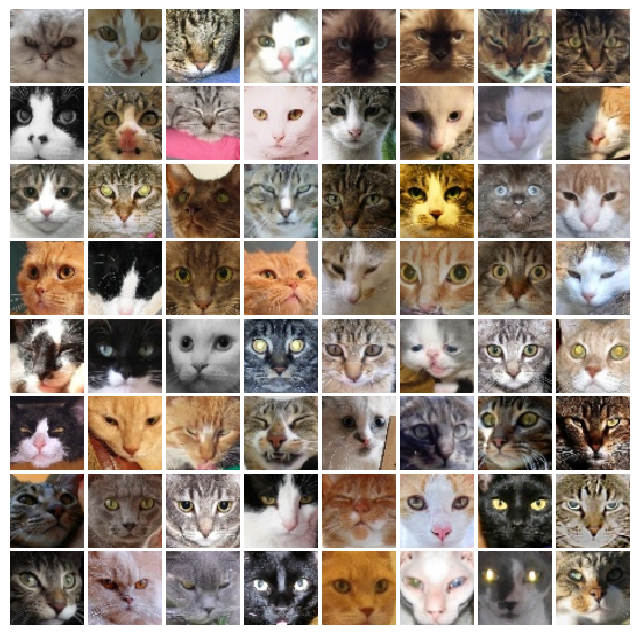

In [8]:
from gan.utils import show_images

try:
  imgs = next(iter(cat_loader_train))[0].numpy().squeeze()
except:
  imgs = cat_loader_train.__iter__().next()[0].numpy().squeeze()

show_images(imgs, color=True)

# Training


**TODO:** Fill in the training loop in `gan/train.py`.

In [19]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.0001

### Train GAN

In [20]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [21]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 1.56, G:3.78


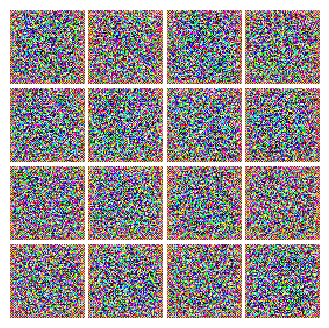


EPOCH:  2
Iter: 250, D: 0.3662, G:5.398


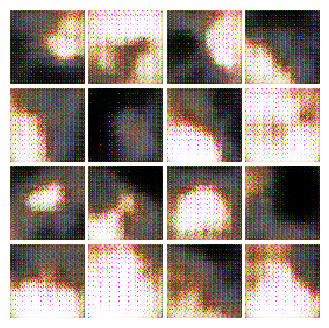


EPOCH:  3
Iter: 500, D: 1.742, G:3.411


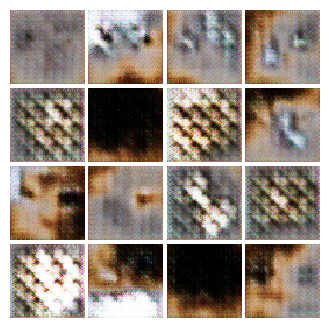


EPOCH:  4
Iter: 750, D: 0.4915, G:4.31


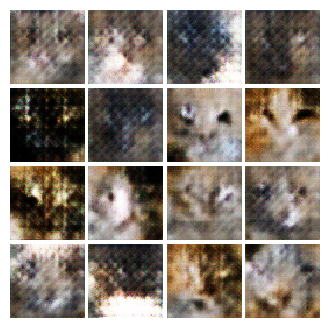


EPOCH:  5
Iter: 1000, D: 0.5501, G:5.426


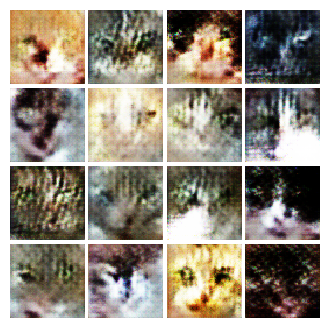


EPOCH:  6
Iter: 1250, D: 0.4995, G:4.554


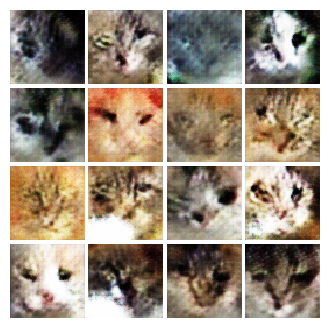


EPOCH:  7
Iter: 1500, D: 0.3902, G:3.229


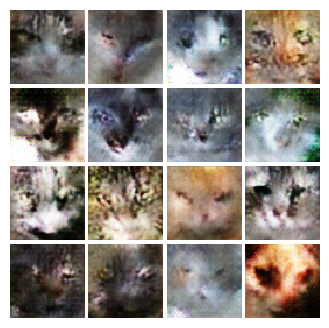


EPOCH:  8
Iter: 1750, D: 0.4106, G:2.044


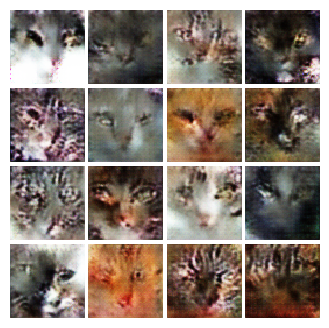


EPOCH:  9
Iter: 2000, D: 0.4996, G:2.569


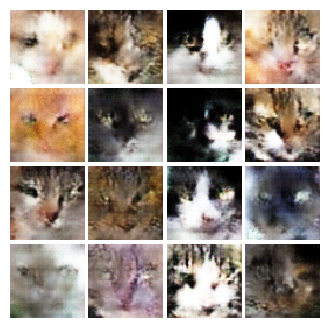


EPOCH:  10
Iter: 2250, D: 0.4237, G:4.076


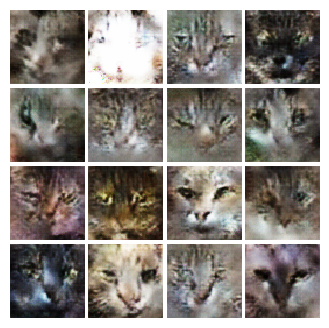


EPOCH:  11
Iter: 2500, D: 2.167, G:4.065


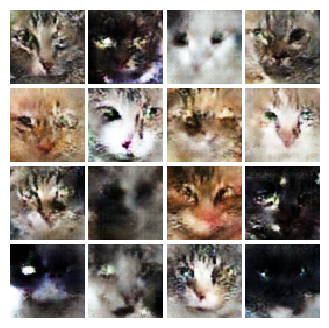


EPOCH:  12
Iter: 2750, D: 0.5076, G:2.675


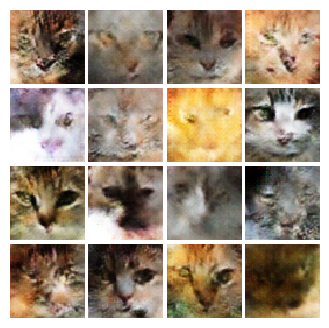


EPOCH:  13
Iter: 3000, D: 0.3234, G:1.928


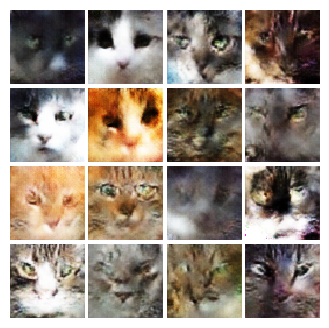


EPOCH:  14
Iter: 3250, D: 0.579, G:4.002


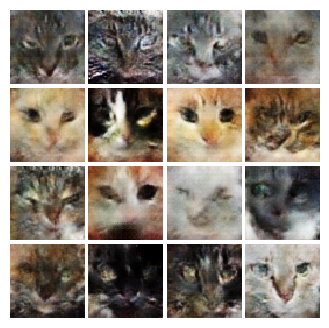


EPOCH:  15
Iter: 3500, D: 0.1206, G:3.857


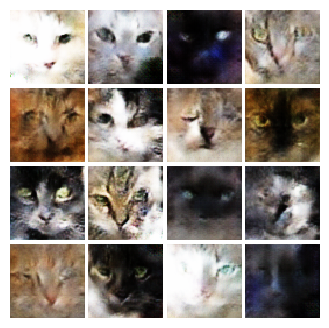


EPOCH:  16
Iter: 3750, D: 0.3173, G:3.669


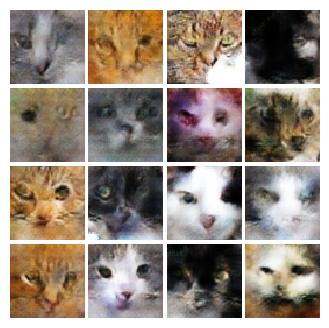


EPOCH:  17
Iter: 4000, D: 1.097, G:5.893


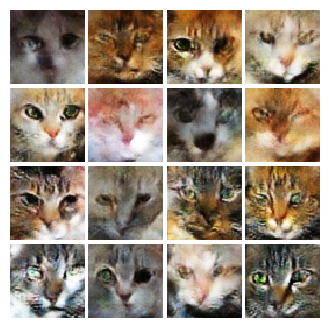


EPOCH:  18
EPOCH:  19
Iter: 4250, D: 0.4334, G:4.437


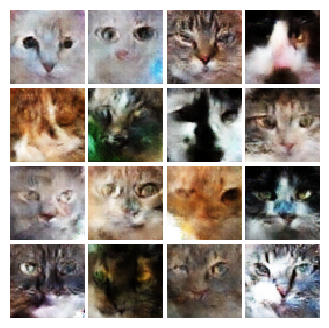


EPOCH:  20
Iter: 4500, D: 0.8031, G:5.537


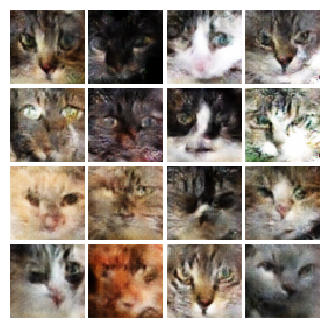


EPOCH:  21
Iter: 4750, D: 0.0898, G:7.856


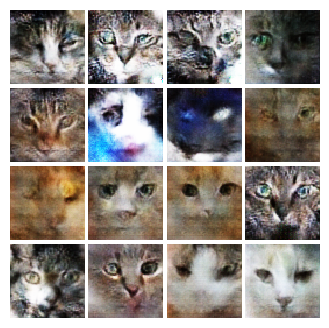


EPOCH:  22
Iter: 5000, D: 0.175, G:3.852


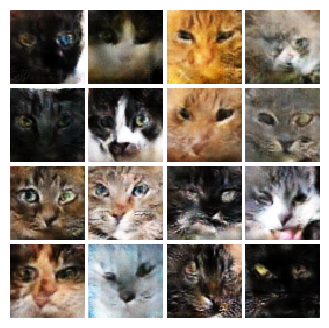


EPOCH:  23
Iter: 5250, D: 0.1553, G:5.22


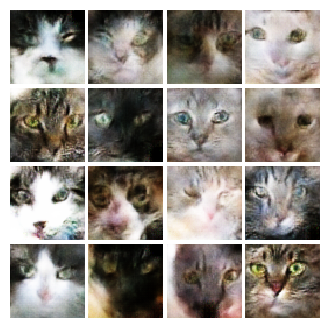


EPOCH:  24
Iter: 5500, D: 0.194, G:4.996


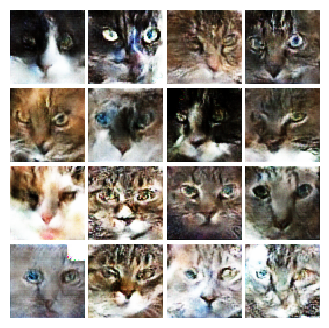


EPOCH:  25
Iter: 5750, D: 0.1078, G:4.135


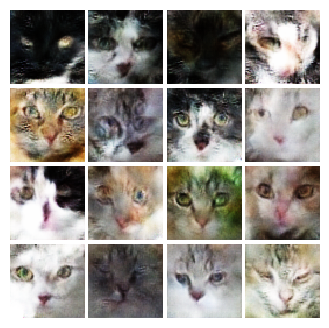


EPOCH:  26
Iter: 6000, D: 0.2532, G:3.189


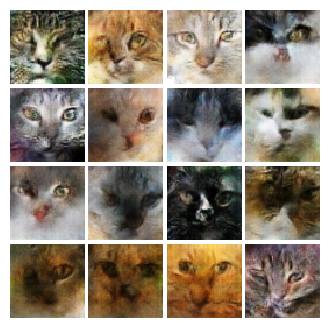


EPOCH:  27
Iter: 6250, D: 1.025, G:1.062


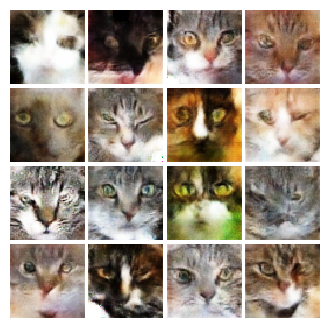


EPOCH:  28
Iter: 6500, D: 0.2398, G:6.03


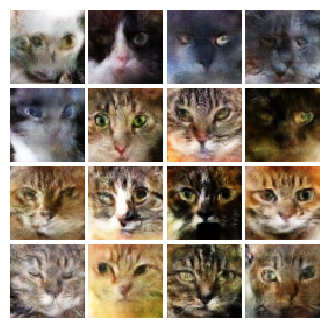


EPOCH:  29
Iter: 6750, D: 0.07591, G:5.333


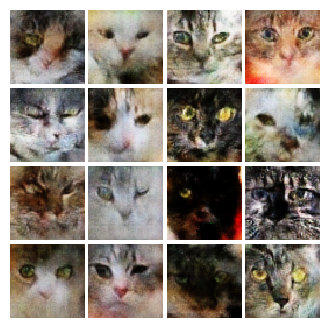


EPOCH:  30
Iter: 7000, D: 0.3136, G:5.263


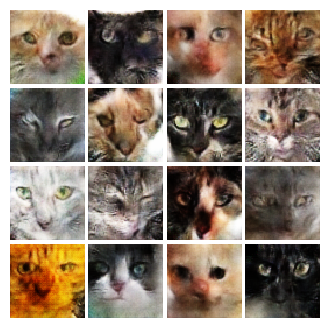


EPOCH:  31
Iter: 7250, D: 0.01968, G:5.391


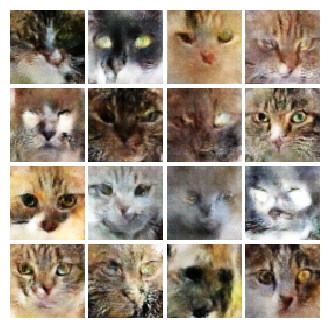


EPOCH:  32
Iter: 7500, D: 0.2477, G:4.754


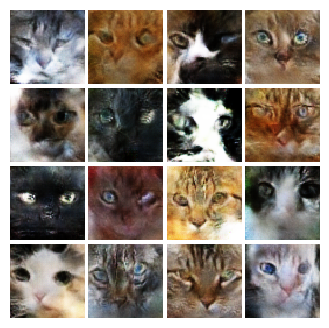


EPOCH:  33
Iter: 7750, D: 0.2976, G:2.23


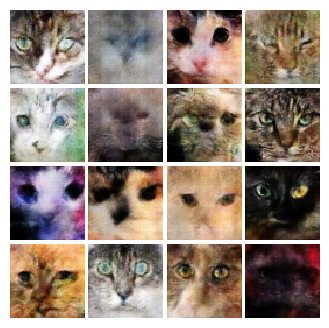


EPOCH:  34
Iter: 8000, D: 0.3967, G:3.065


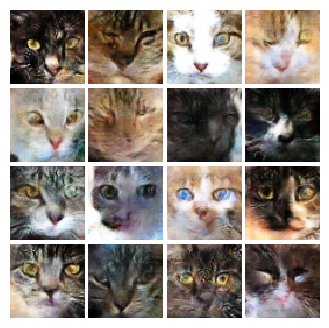


EPOCH:  35
Iter: 8250, D: 0.09457, G:4.237


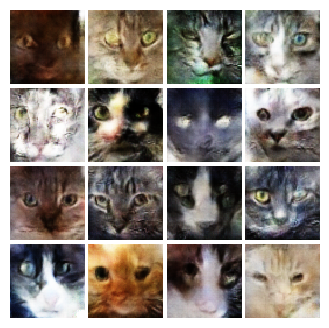


EPOCH:  36
EPOCH:  37
Iter: 8500, D: 0.1244, G:5.038


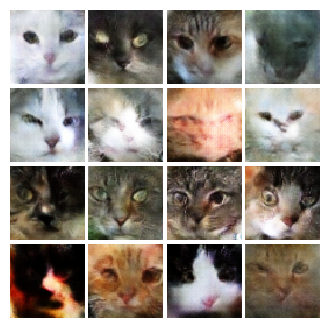


EPOCH:  38
Iter: 8750, D: 0.3485, G:6.405


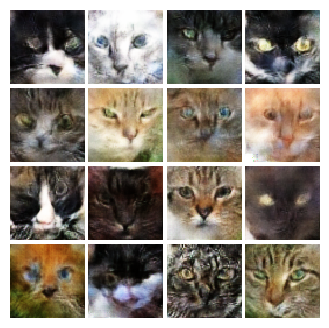


EPOCH:  39
Iter: 9000, D: 0.08593, G:4.799


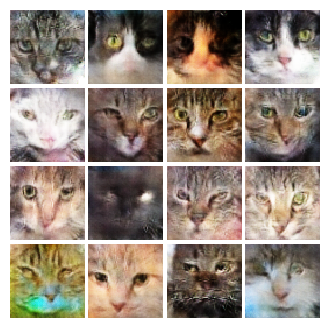


EPOCH:  40
Iter: 9250, D: 0.4142, G:2.82


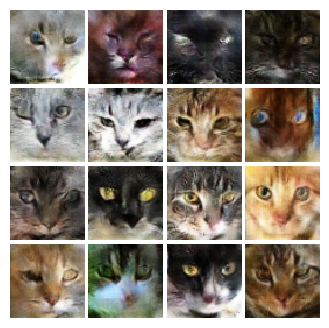


EPOCH:  41
Iter: 9500, D: 0.02023, G:5.61


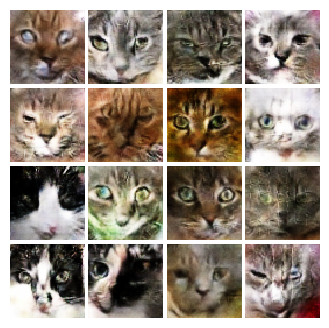


EPOCH:  42
Iter: 9750, D: 0.05673, G:4.812


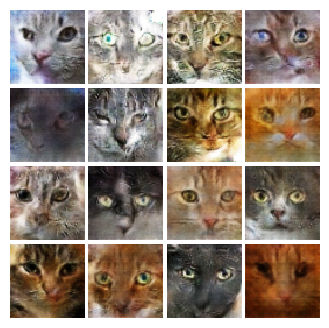


EPOCH:  43
Iter: 10000, D: 0.5209, G:2.684


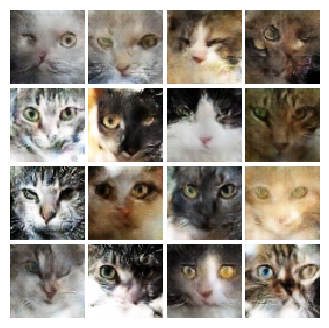


EPOCH:  44
Iter: 10250, D: 0.3228, G:7.388


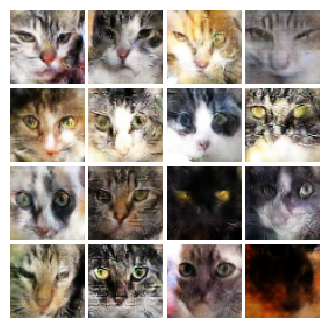


EPOCH:  45
Iter: 10500, D: 0.1123, G:4.667


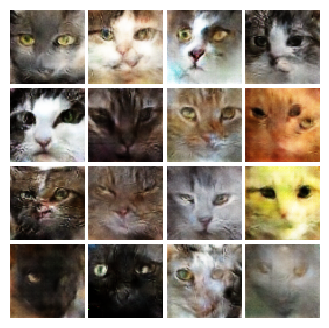


EPOCH:  46
Iter: 10750, D: 0.1707, G:5.188


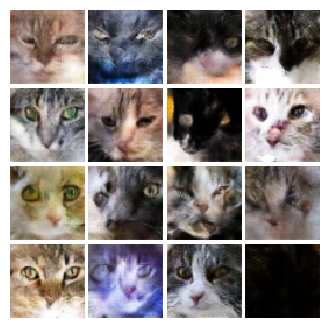


EPOCH:  47
Iter: 11000, D: 0.1594, G:3.739


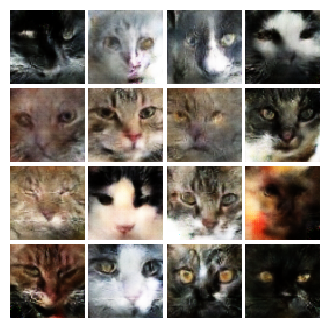


EPOCH:  48
Iter: 11250, D: 0.1559, G:5.568


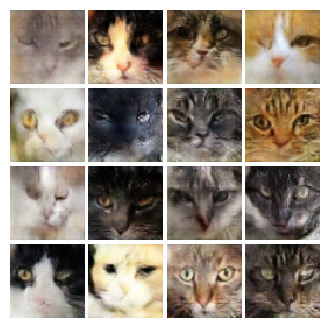


EPOCH:  49
Iter: 11500, D: 0.2537, G:4.428


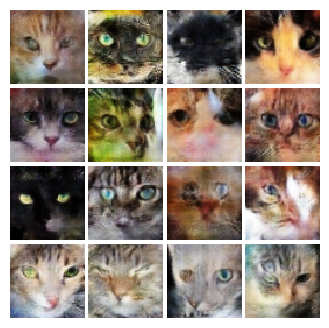


EPOCH:  50
Iter: 11750, D: 0.7485, G:9.692


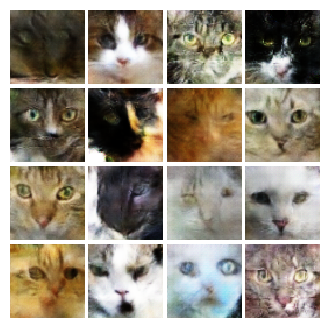

In [22]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss,
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device,noise_size = NOISE_DIM)


### Train LS-GAN

In [27]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [28]:
# learning_rate = 1e-5
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.803, G:0.4247


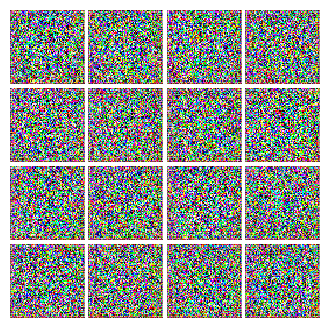


EPOCH:  2
Iter: 250, D: 0.04644, G:0.473


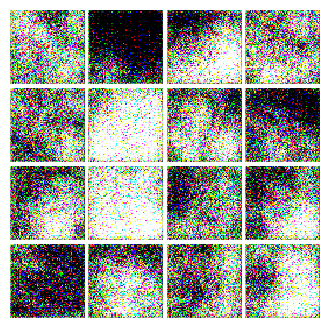


EPOCH:  3
Iter: 500, D: 0.01796, G:0.477


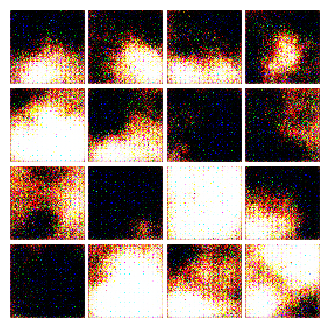


EPOCH:  4
Iter: 750, D: 0.1068, G:0.4691


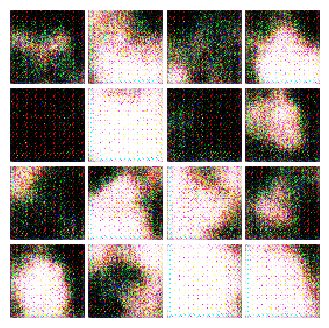


EPOCH:  5
Iter: 1000, D: 0.02602, G:0.3828


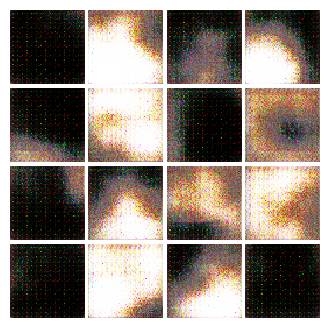


EPOCH:  6
Iter: 1250, D: 0.02016, G:0.5638


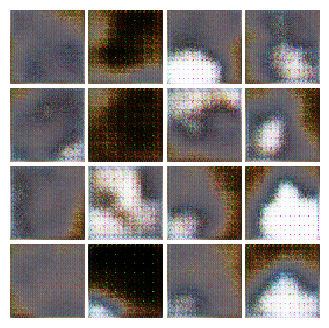


EPOCH:  7
Iter: 1500, D: 0.02671, G:0.5084


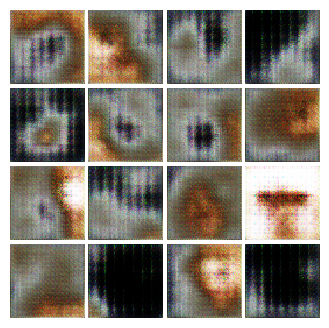


EPOCH:  8
Iter: 1750, D: 0.1385, G:0.6802


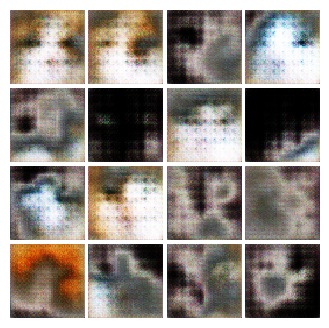


EPOCH:  9
Iter: 2000, D: 0.3108, G:0.6091


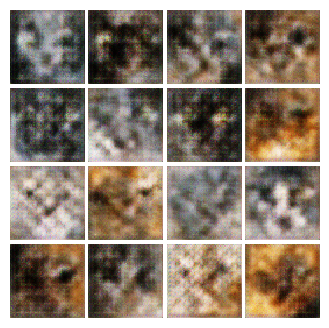


EPOCH:  10
Iter: 2250, D: 0.05244, G:0.4322


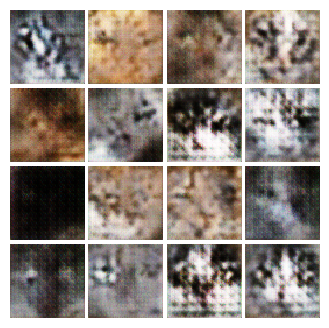


EPOCH:  11
Iter: 2500, D: 0.05297, G:0.497


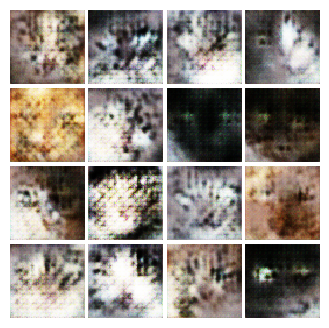


EPOCH:  12
Iter: 2750, D: 0.06968, G:0.4297


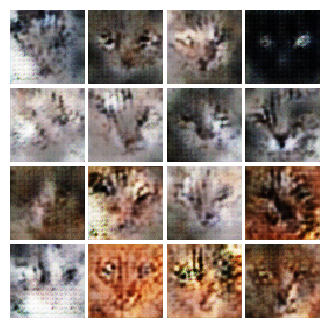


EPOCH:  13
Iter: 3000, D: 0.03744, G:0.4034


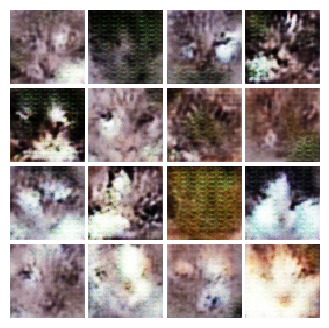


EPOCH:  14
Iter: 3250, D: 0.2033, G:0.7554


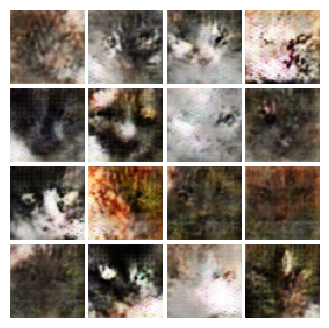


EPOCH:  15
Iter: 3500, D: 0.0507, G:0.4916


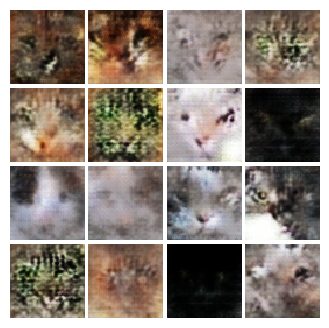


EPOCH:  16
Iter: 3750, D: 0.04288, G:0.547


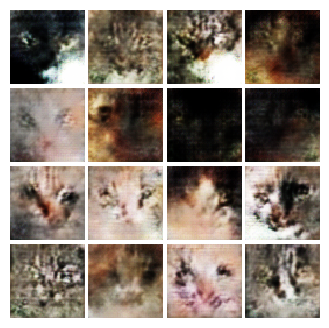


EPOCH:  17
Iter: 4000, D: 0.04226, G:0.5572


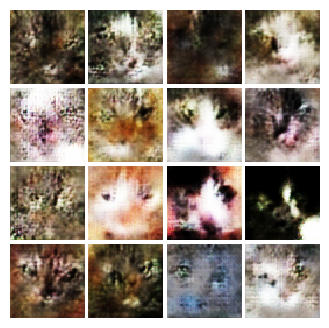


EPOCH:  18
EPOCH:  19
Iter: 4250, D: 0.05446, G:0.4237


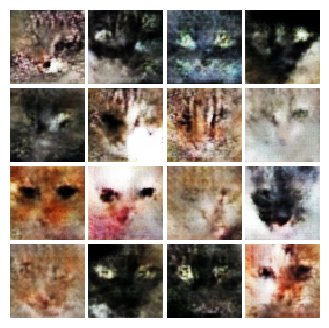


EPOCH:  20
Iter: 4500, D: 0.04803, G:0.4305


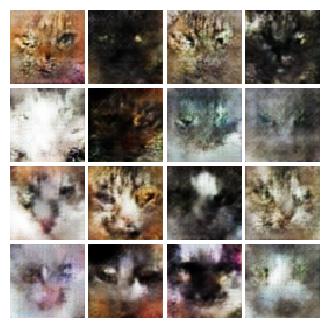


EPOCH:  21
Iter: 4750, D: 0.2301, G:0.3695


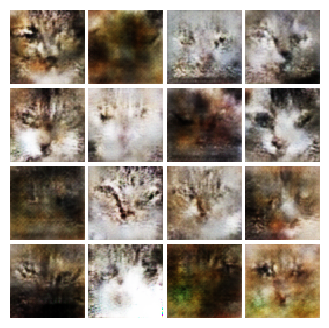


EPOCH:  22
Iter: 5000, D: 0.1128, G:0.6548


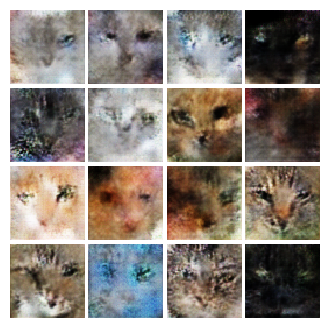


EPOCH:  23
Iter: 5250, D: 0.1649, G:0.5928


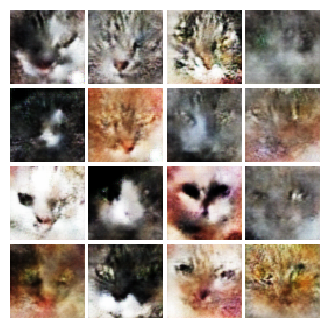


EPOCH:  24
Iter: 5500, D: 0.1098, G:0.4449


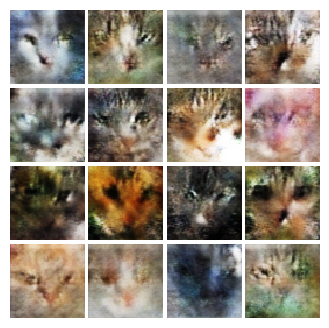


EPOCH:  25
Iter: 5750, D: 0.1342, G:0.3466


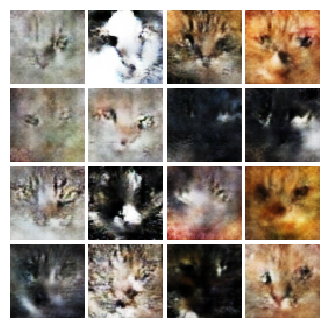


EPOCH:  26
Iter: 6000, D: 0.04884, G:0.3844


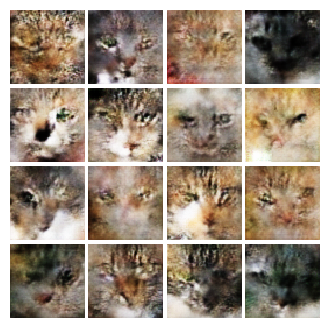


EPOCH:  27
Iter: 6250, D: 0.1834, G:0.8605


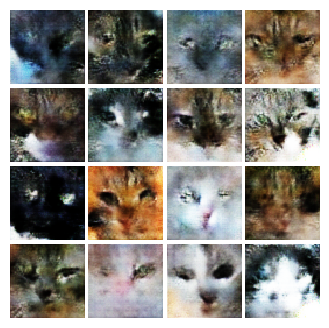


EPOCH:  28
Iter: 6500, D: 0.0283, G:0.4341


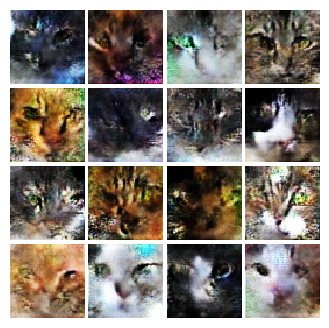


EPOCH:  29
Iter: 6750, D: 0.02319, G:0.5233


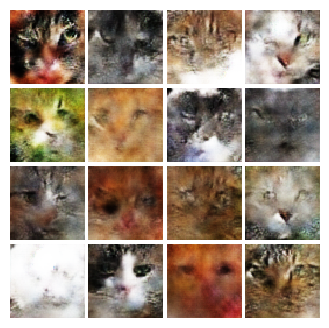


EPOCH:  30
Iter: 7000, D: 0.06097, G:0.4169


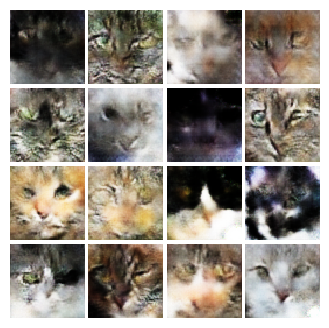


EPOCH:  31
Iter: 7250, D: 0.03691, G:0.4928


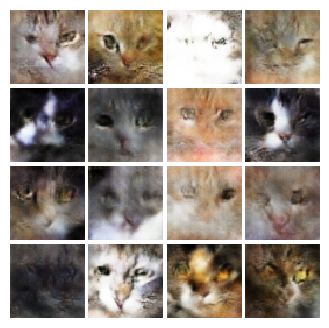


EPOCH:  32
Iter: 7500, D: 0.02227, G:0.4291


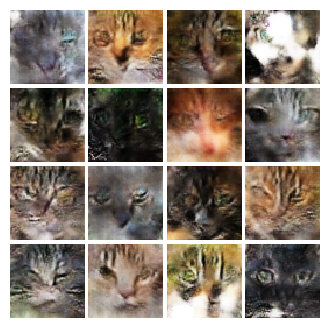


EPOCH:  33
Iter: 7750, D: 0.1061, G:0.8916


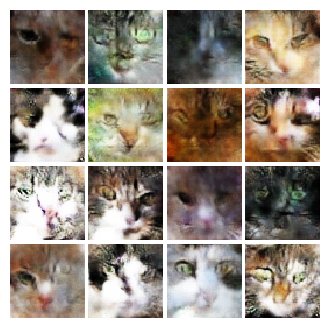


EPOCH:  34
Iter: 8000, D: 0.1039, G:0.2482


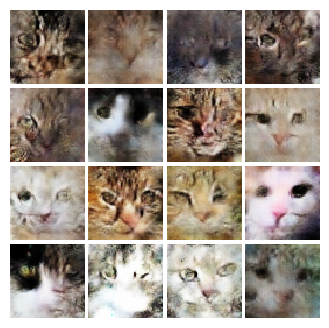


EPOCH:  35
Iter: 8250, D: 0.1315, G:0.3259


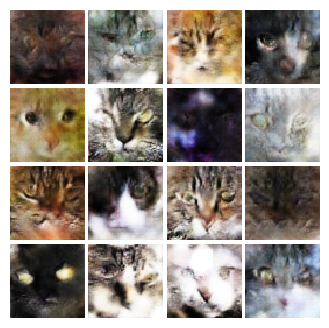


EPOCH:  36
EPOCH:  37
Iter: 8500, D: 0.1166, G:0.8671


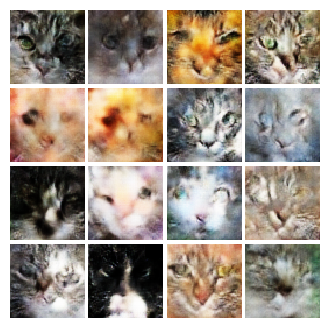


EPOCH:  38
Iter: 8750, D: 0.05588, G:0.332


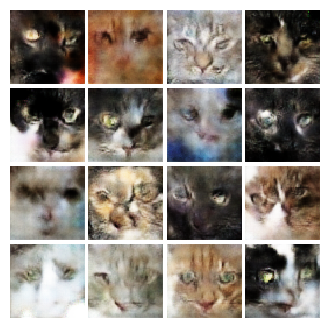


EPOCH:  39
Iter: 9000, D: 0.09462, G:0.7209


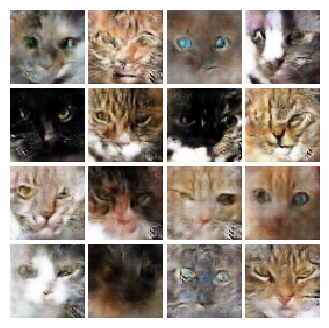


EPOCH:  40
Iter: 9250, D: 0.07214, G:0.6026


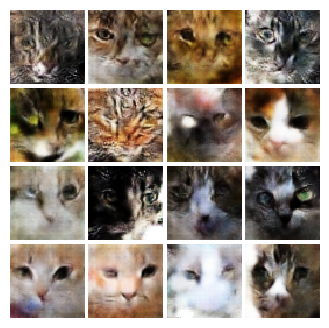


EPOCH:  41
Iter: 9500, D: 0.03381, G:0.5168


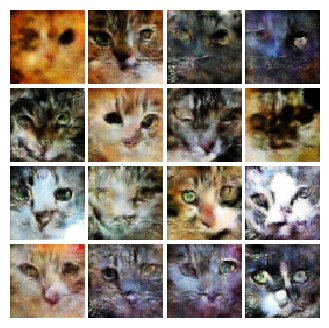


EPOCH:  42
Iter: 9750, D: 0.07851, G:0.2215


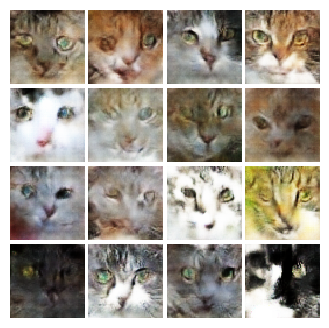


EPOCH:  43
Iter: 10000, D: 0.07716, G:0.4242


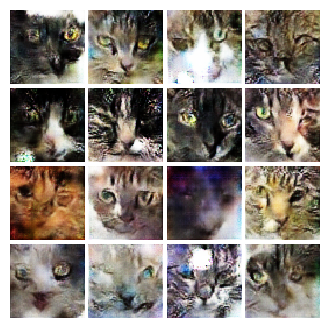


EPOCH:  44
Iter: 10250, D: 0.1421, G:0.8722


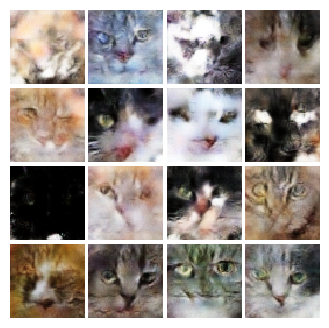


EPOCH:  45
Iter: 10500, D: 0.02759, G:0.556


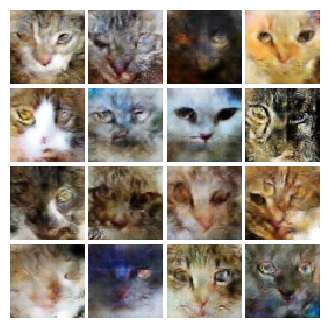


EPOCH:  46
Iter: 10750, D: 0.08523, G:0.2382


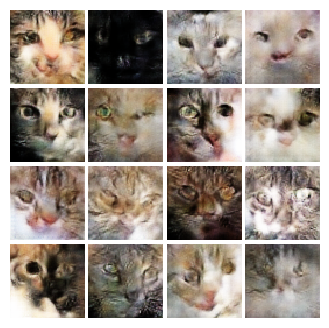


EPOCH:  47
Iter: 11000, D: 0.1015, G:0.3743


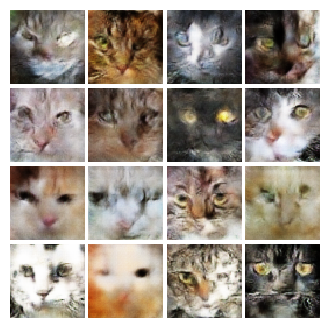


EPOCH:  48
Iter: 11250, D: 0.03386, G:0.6044


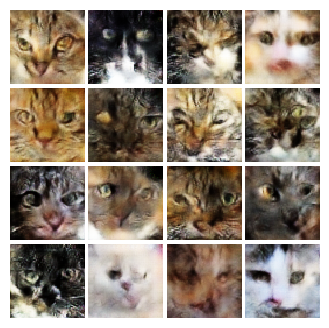


EPOCH:  49
Iter: 11500, D: 0.04209, G:0.3804


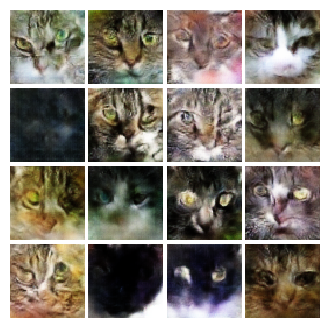


EPOCH:  50
Iter: 11750, D: 0.04254, G:0.5564


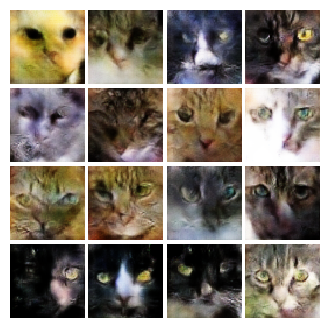

In [29]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss,
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device,noise_size=NOISE_DIM)